In [94]:
#import all neccessary libraries

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sn
import warnings
warnings.filterwarnings("ignore")

from sklearn.model_selection import train_test_split


In [95]:
df=pd.read_csv("HR_Analytics.csv.csv")    #read .csv file
df.head()                                 #display first 5 entries

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,Yes,Travel_Rarely,1102,Sales,1,2,Life Sciences,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,No,Travel_Frequently,279,Research & Development,8,1,Life Sciences,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,Yes,Travel_Rarely,1373,Research & Development,2,2,Other,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,No,Travel_Frequently,1392,Research & Development,3,4,Life Sciences,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,No,Travel_Rarely,591,Research & Development,2,1,Medical,1,7,...,4,80,1,6,3,3,2,2,2,2


In [96]:
#EDA AND PREPROCESSING
df.info()    #display total no. of rows,cols, dtypes,null values

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype 
---  ------                    --------------  ----- 
 0   Age                       1470 non-null   int64 
 1   Attrition                 1470 non-null   object
 2   BusinessTravel            1470 non-null   object
 3   DailyRate                 1470 non-null   int64 
 4   Department                1470 non-null   object
 5   DistanceFromHome          1470 non-null   int64 
 6   Education                 1470 non-null   int64 
 7   EducationField            1470 non-null   object
 8   EmployeeCount             1470 non-null   int64 
 9   EmployeeNumber            1470 non-null   int64 
 10  EnvironmentSatisfaction   1470 non-null   int64 
 11  Gender                    1470 non-null   object
 12  HourlyRate                1470 non-null   int64 
 13  JobInvolvement            1470 non-null   int64 
 14  JobLevel                

In [97]:
df.size   #total entries

51450

In [98]:
df.shape    #no. of rows and cols

(1470, 35)

In [99]:
df.isna().sum()    #no null value present,or no missing value

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [100]:
df_duplicate_val=df[df.duplicated()]   #duplicate value
df_duplicate_val.count()               #counts duplicate val

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

In [101]:
catcol=df.select_dtypes(object).columns

In [102]:
from sklearn.preprocessing import OrdinalEncoder

In [103]:
oe=OrdinalEncoder()
df[catcol]=oe.fit_transform(df[catcol])   #convert object column to numeric column

In [104]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1.0,2.0,1102,2.0,1,2,1.0,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,0.0,1.0,279,1.0,8,1,1.0,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,1.0,2.0,1373,1.0,2,2,4.0,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,0.0,1.0,1392,1.0,3,4,1.0,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,0.0,2.0,591,1.0,2,1,3.0,1,7,...,4,80,1,6,3,3,2,2,2,2


In [105]:
df.info()   

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       1470 non-null   int64  
 1   Attrition                 1470 non-null   float64
 2   BusinessTravel            1470 non-null   float64
 3   DailyRate                 1470 non-null   int64  
 4   Department                1470 non-null   float64
 5   DistanceFromHome          1470 non-null   int64  
 6   Education                 1470 non-null   int64  
 7   EducationField            1470 non-null   float64
 8   EmployeeCount             1470 non-null   int64  
 9   EmployeeNumber            1470 non-null   int64  
 10  EnvironmentSatisfaction   1470 non-null   int64  
 11  Gender                    1470 non-null   float64
 12  HourlyRate                1470 non-null   int64  
 13  JobInvolvement            1470 non-null   int64  
 14  JobLevel

In [106]:
df.head()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,41,1.0,2.0,1102,2.0,1,2,1.0,1,1,...,1,80,0,8,0,1,6,4,0,5
1,49,0.0,1.0,279,1.0,8,1,1.0,1,2,...,4,80,1,10,3,3,10,7,1,7
2,37,1.0,2.0,1373,1.0,2,2,4.0,1,4,...,2,80,0,7,3,3,0,0,0,0
3,33,0.0,1.0,1392,1.0,3,4,1.0,1,5,...,3,80,0,8,3,3,8,7,3,0
4,27,0.0,2.0,591,1.0,2,1,3.0,1,7,...,4,80,1,6,3,3,2,2,2,2


In [107]:
df.isnull()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeCount,EmployeeNumber,...,RelationshipSatisfaction,StandardHours,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1465,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1466,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1467,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
1468,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [108]:
df.isnull().sum()

Age                         0
Attrition                   0
BusinessTravel              0
DailyRate                   0
Department                  0
DistanceFromHome            0
Education                   0
EducationField              0
EmployeeCount               0
EmployeeNumber              0
EnvironmentSatisfaction     0
Gender                      0
HourlyRate                  0
JobInvolvement              0
JobLevel                    0
JobRole                     0
JobSatisfaction             0
MaritalStatus               0
MonthlyIncome               0
MonthlyRate                 0
NumCompaniesWorked          0
Over18                      0
OverTime                    0
PercentSalaryHike           0
PerformanceRating           0
RelationshipSatisfaction    0
StandardHours               0
StockOptionLevel            0
TotalWorkingYears           0
TrainingTimesLastYear       0
WorkLifeBalance             0
YearsAtCompany              0
YearsInCurrentRole          0
YearsSince

<AxesSubplot:xlabel='StockOptionLevel', ylabel='count'>

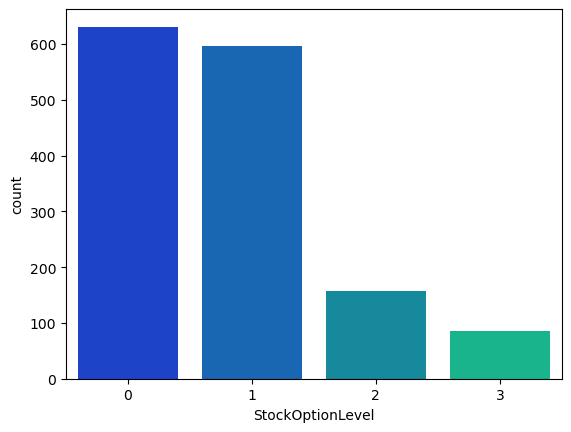

In [109]:

sn.countplot(data=df,x="StockOptionLevel",palette="winter")

In [110]:
df["StockOptionLevel"].value_counts()

0    631
1    596
2    158
3     85
Name: StockOptionLevel, dtype: int64

<AxesSubplot:xlabel='Attrition', ylabel='count'>

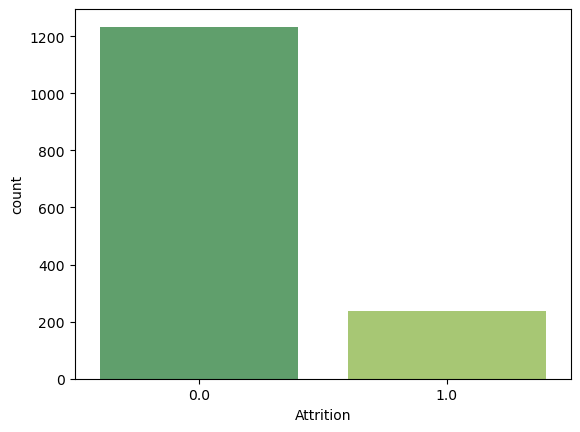

In [111]:
sn.countplot(data=df,x="Attrition",palette="summer")

<AxesSubplot:xlabel='Gender', ylabel='count'>

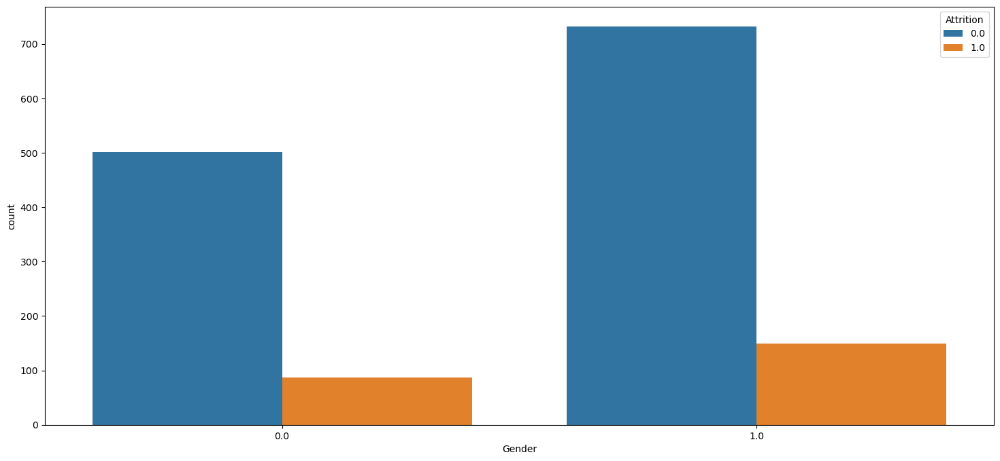

In [112]:
plt.figure(figsize=(18,8))
sn.countplot(data=df,x="Gender",hue="Attrition")    #genderwise attrition

from above graph,we conclude that female have less attrition  than male.

<AxesSubplot:xlabel='Age', ylabel='count'>

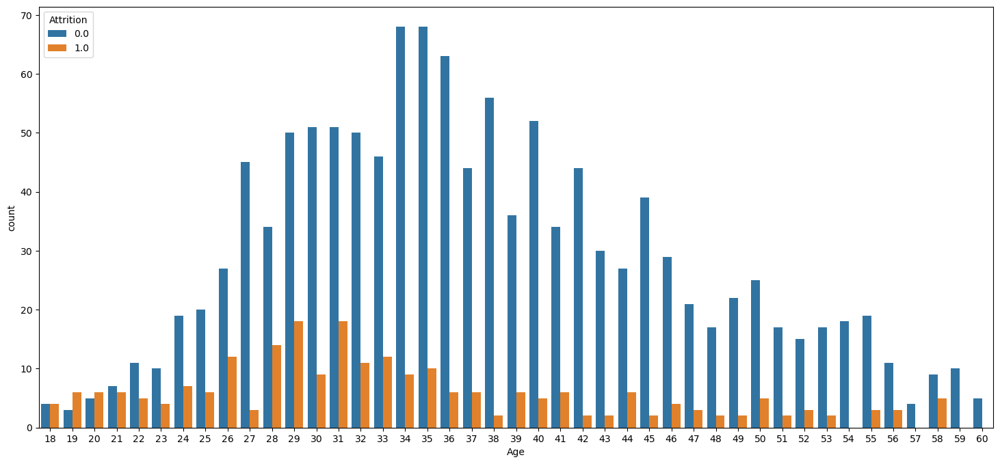

In [113]:
plt.figure(figsize=(18,8))
sn.countplot(data=df,x="Age",hue="Attrition")  #age wise attrition count

According to age consideration ages between 29 to 31 having more attrition rate.

<AxesSubplot:xlabel='PercentSalaryHike', ylabel='Density'>

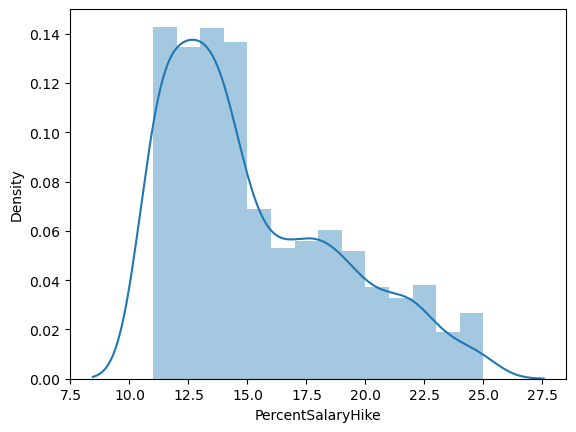

In [114]:
sn.distplot(df["PercentSalaryHike"])

<AxesSubplot:ylabel='WorkLifeBalance'>

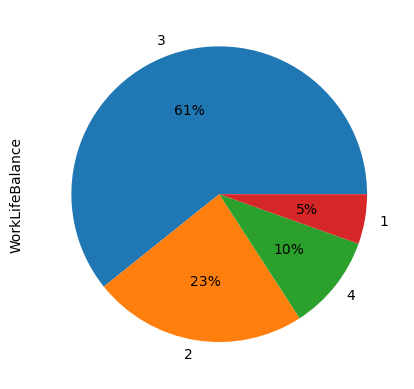

In [115]:
df['WorkLifeBalance'].value_counts().plot(kind="pie",autopct="%.0f%%")

<AxesSubplot:ylabel='MaritalStatus'>

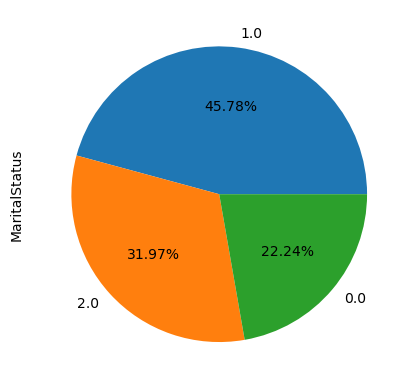

In [116]:
df['MaritalStatus'].value_counts().plot(kind="pie",autopct="%.02f%%")

In [117]:
sn.pairplot(data=df,hue="Attrition")

In [118]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1470 entries, 0 to 1469
Data columns (total 35 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Age                       1470 non-null   int64  
 1   Attrition                 1470 non-null   float64
 2   BusinessTravel            1470 non-null   float64
 3   DailyRate                 1470 non-null   int64  
 4   Department                1470 non-null   float64
 5   DistanceFromHome          1470 non-null   int64  
 6   Education                 1470 non-null   int64  
 7   EducationField            1470 non-null   float64
 8   EmployeeCount             1470 non-null   int64  
 9   EmployeeNumber            1470 non-null   int64  
 10  EnvironmentSatisfaction   1470 non-null   int64  
 11  Gender                    1470 non-null   float64
 12  HourlyRate                1470 non-null   int64  
 13  JobInvolvement            1470 non-null   int64  
 14  JobLevel

In [119]:
from sklearn.impute import SimpleImputer

In [120]:
si=SimpleImputer(missing_values=np.nan,strategy="mean")

In [121]:
#df[["EmployeeCount","Over18","StandardHours"]]=si.fit_transform(df[["EmployeeCount","Over18","StandardHours"]])

In [82]:
#df=df.corr()

In [122]:
df.drop(["EmployeeCount","Over18","StandardHours"],axis=1,inplace=True)  #drop the cols that r not neccesary

In [123]:
df.corr()

,Age,Attrition,BusinessTravel,DailyRate,Department,DistanceFromHome,Education,EducationField,EmployeeNumber,EnvironmentSatisfaction,...,PerformanceRating,RelationshipSatisfaction,StockOptionLevel,TotalWorkingYears,TrainingTimesLastYear,WorkLifeBalance,YearsAtCompany,YearsInCurrentRole,YearsSinceLastPromotion,YearsWithCurrManager
Age,1.000000,-0.159205,0.024751,0.010661,-0.031882,-0.001686,0.208034,-0.040873,-0.010145,0.010146,...,0.001904,0.053535,0.037510,0.680381,-0.019621,-0.021490,0.311309,0.212901,0.216513,0.202089
Attrition,-0.159205,1.000000,0.000074,-0.056652,0.063991,0.077924,-0.031373,0.026846,-0.010577,-0.103369,...,0.002889,-0.045872,-0.137145,-0.171063,-0.059478,-0.063939,-0.134392,-0.160545,-0.033019,-0.156199
BusinessTravel,0.024751,0.000074,1.000000,-0.004086,-0.009044,-0.024469,0.000757,0.023724,-0.015578,0.004174,...,-0.026341,-0.035986,-0.016727,0.034226,0.015240,-0.011256,-0.014575,-0.011497,-0.032591,-0.022636
DailyRate,0.010661,-0.056652,-0.004086,1.000000,0.007109,-0.004985,-0.016806,0.037709,-0.050990,0.018355,...,0.000473,0.007846,0.042143,0.014515,0.002453,-0.037848,-0.034055,0.009932,-0.033229,-0.026363
Department,-0.031882,0.063991,-0.009044,0.007109,1.000000,0.017225,0.007996,0.013720,-0.010895,-0.019395,...,-0.024604,-0.022414,-0.012193,-0.015762,0.036875,0.026383,0.022920,0.056315,0.040061,0.034282
DistanceFromHome,-0.001686,0.077924,-0.024469,-0.004985,0.017225,1.000000,0.021042,0.002013,0.032916,-0.016075,...,0.027110,0.006557,0.044872,0.004628,-0.036942,-0.026556,0.009508,0.018845,0.010029,0.014406
Education,0.208034,-0.031373,0.000757,-0.016806,0.007996,0.021042,1.000000,-0.039592,0.042070,-0.027128,...,-0.024539,-0.009118,0.018422,0.148280,-0.025100,0.009819,0.069114,0.060236,0.054254,0.069065
EducationField,-0.040873,0.026846,0.023724,0.037709,0.013720,0.002013,-0.039592,1.000000,-0.002516,0.043163,...,-0.005614,-0.004378,-0.016185,-0.027848,0.049195,0.041191,-0.018692,-0.010506,0.002326,-0.004130
EmployeeNumber,-0.010145,-0.010577,-0.015578,-0.050990,-0.010895,0.032916,0.042070,-0.002516,1.000000,0.017621,...,-0.020359,-0.069861,0.062227,-0.014365,0.023603,0.010309,-0.011240,-0.008416,-0.009019,-0.009197
EnvironmentSatisfaction,0.010146,-0.103369,0.004174,0.018355,-0.019395,-0.016075,-0.027128,0.043163,0.017621,1.000000,...,-0.029548,0.007665,0.003432,-0.002693,-0.019359,0.027627,0.001458,0.018007,0.016194,-0.004999


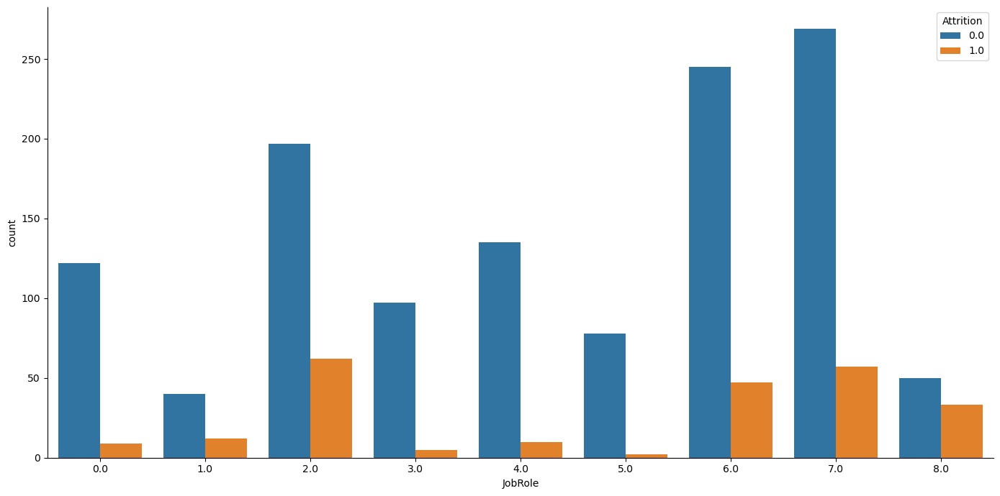

In [124]:
#departmentwise attrition
sn.catplot(x="JobRole",hue="Attrition",data=df,kind="count",height=7,aspect=2,legend=False)
plt.legend(loc='upper right',title='Attrition')
plt.show()

Here Sales Executive,Research scientist,Laboratory,sales Representative deapartment having high attrition.

In [125]:
# Train and test data

In [126]:
x=df.iloc[:,:-1]
y=df.iloc[:,-1]

In [127]:
xtrain, xtest, ytrain, ytest = train_test_split(x,y, test_size=0.25, random_state=0)

In [128]:
print(xtrain)
print(xtest)
print(ytrain) 
print(ytest)

      Age  Attrition  BusinessTravel  DailyRate  Department  DistanceFromHome  \
944    28        0.0             0.0       1476         1.0                 1   
1402   31        0.0             2.0       1276         1.0                 2   
1054   49        0.0             2.0       1490         1.0                 7   
1128   36        0.0             1.0       1302         1.0                 6   
1323   28        0.0             0.0        280         0.0                 1   
...   ...        ...             ...        ...         ...               ...   
763    34        0.0             2.0       1333         2.0                10   
835    35        0.0             2.0        528         0.0                 8   
1216   43        0.0             2.0       1179         2.0                 2   
559    38        0.0             2.0        268         1.0                 2   
684    40        0.0             2.0        658         2.0                10   

      Education  EducationF

In [129]:
#creating logistic model for regression
from sklearn.linear_model import LogisticRegression

In [130]:
logistic_regression= LogisticRegression() #obj(model)=classname()
logistic_regression.fit(xtrain,ytrain)#training model(calculation)


LogisticRegression()

In [131]:
ypred=logistic_regression.predict(xtest)

print (xtest) #test dataset
print (ypred) #predicted values

      Age  Attrition  BusinessTravel  DailyRate  Department  DistanceFromHome  \
442    36        0.0             0.0        635         2.0                10   
1091   33        0.0             2.0        575         1.0                25   
981    35        1.0             1.0        662         2.0                18   
785    40        0.0             2.0       1492         1.0                20   
1332   29        1.0             1.0        459         1.0                24   
...   ...        ...             ...        ...         ...               ...   
557    35        0.0             0.0       1225         1.0                 2   
831    31        1.0             1.0        874         1.0                15   
686    41        0.0             2.0        263         1.0                 6   
969    48        0.0             2.0        855         1.0                 4   
1395   31        1.0             1.0        754         2.0                26   

      Education  EducationF

In [132]:
print(ytest)#actual y

442      7
1091     2
981      2
785      1
1332     0
        ..
557      0
831      2
686     17
969      8
1395     8
Name: YearsWithCurrManager, Length: 368, dtype: int64


In [133]:
logistic_regression.score(xtest,ytest)

0.25271739130434784

In [134]:
logistic_regression.score(xtrain,ytrain)

0.24319419237749546

Logistic regression having very low score

In [135]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, accuracy_score

In [136]:
models=[]
accuracy=[]

models.append(("logreg",LogisticRegression()))
models.append(("DT",DecisionTreeClassifier()))
models.append(("DT-e",DecisionTreeClassifier(criterion="entropy")))
models

[('logreg', LogisticRegression()),
 ('DT', DecisionTreeClassifier()),
 ('DT-e', DecisionTreeClassifier(criterion='entropy'))]

In [137]:
for name,model in models:
    model.fit(xtrain,ytrain)
    ypred=model.predict(xtest)
    ac=accuracy_score(ytest,ypred)
    accuracy.append(ac)

In [138]:
accuracy

[0.25271739130434784, 0.4701086956521739, 0.483695652173913]

In [139]:
arr=np.array(accuracy)
print("average accuracy",arr.mean())

average accuracy 0.40217391304347827


In [140]:
from sklearn.ensemble import VotingClassifier

In [141]:
vc=VotingClassifier(estimators=models)
vc.fit(xtrain,ytrain)
ypred=vc.predict(xtest)

In [142]:
train=vc.score(xtrain,ytrain)
test=vc.score(xtest,ytest)

print("training accuracy",train)
print("testing accuracy",test)
print(classification_report(ytest,ypred))

training accuracy 1.0
testing accuracy 0.43478260869565216
              precision    recall  f1-score   support

           0       0.69      0.69      0.69        64
           1       0.10      0.15      0.12        13
           2       0.43      0.86      0.58        85
           3       0.67      0.26      0.38        46
           4       0.20      0.10      0.13        21
           5       0.00      0.00      0.00         3
           6       0.00      0.00      0.00         6
           7       0.40      0.47      0.43        53
           8       0.11      0.03      0.05        29
           9       0.14      0.06      0.08        18
          10       0.00      0.00      0.00        10
          11       0.00      0.00      0.00         7
          12       0.00      0.00      0.00         1
          13       0.00      0.00      0.00         5
          14       0.00      0.00      0.00         3
          15       0.00      0.00      0.00         2
          17       0.0

In [143]:
#bagging

from sklearn import model_selection
from sklearn.ensemble import BaggingClassifier

In [144]:
seed = 8
kfold = model_selection.KFold(n_splits = 3,random_state = 1,shuffle=True)

In [145]:
# initialize the base classifier
base_cls = DecisionTreeClassifier()
 
# no. of base classifier
num_trees = 500

In [146]:
# bagging classifier
model = BaggingClassifier(base_estimator = base_cls,
                          n_estimators = num_trees,
                          random_state = seed)

In [147]:
results = model_selection.cross_val_score(model, x, y, cv = kfold)
print("accuracy :")
print(results.mean())

accuracy :
0.5061224489795918


In [148]:
#boosting

def mymodel(model):
    model.fit(xtrain,ytrain)
    ypred=model.predict(xtest)
    train=model.score(xtrain,ytrain)
    test=model.score(xtest,ytest)
    print("training accuracy",train)
    print("testing score",test)
    print(classification_report(ytest,ypred))

In [149]:
from sklearn.ensemble import AdaBoostClassifier,GradientBoostingClassifier

In [150]:
mymodel(AdaBoostClassifier())

training accuracy 0.17604355716878403
testing score 0.23641304347826086
              precision    recall  f1-score   support

           0       0.93      0.22      0.35        64
           1       0.00      0.00      0.00        13
           2       0.37      0.22      0.28        85
           3       0.18      0.80      0.29        46
           4       0.00      0.00      0.00        21
           5       0.00      0.00      0.00         3
           6       0.00      0.00      0.00         6
           7       0.12      0.13      0.12        53
           8       0.31      0.34      0.33        29
           9       0.00      0.00      0.00        18
          10       0.00      0.00      0.00        10
          11       0.00      0.00      0.00         7
          12       0.00      0.00      0.00         1
          13       0.00      0.00      0.00         5
          14       0.00      0.00      0.00         3
          15       0.00      0.00      0.00         2
         

In [151]:
mymodel(GradientBoostingClassifier())

training accuracy 0.9918330308529946
testing score 0.49728260869565216
              precision    recall  f1-score   support

           0       0.83      0.70      0.76        64
           1       0.25      0.08      0.12        13
           2       0.65      0.84      0.73        85
           3       0.42      0.24      0.31        46
           4       0.26      0.24      0.25        21
           5       0.00      0.00      0.00         3
           6       0.00      0.00      0.00         6
           7       0.45      0.72      0.55        53
           8       0.19      0.21      0.20        29
           9       0.29      0.28      0.29        18
          10       0.33      0.10      0.15        10
          11       0.00      0.00      0.00         7
          12       0.00      0.00      0.00         1
          13       0.00      0.00      0.00         5
          14       0.00      0.00      0.00         3
          15       0.00      0.00      0.00         2
          

In [152]:
from xgboost import XGBClassifier

In [153]:
mymodel(XGBClassifier(max_depth=2))

training accuracy 0.9328493647912885
testing score 0.49184782608695654
              precision    recall  f1-score   support

           0       0.92      0.70      0.80        64
           1       0.25      0.08      0.12        13
           2       0.64      0.82      0.72        85
           3       0.44      0.24      0.31        46
           4       0.37      0.33      0.35        21
           5       0.00      0.00      0.00         3
           6       0.00      0.00      0.00         6
           7       0.44      0.72      0.54        53
           8       0.10      0.14      0.12        29
           9       0.22      0.22      0.22        18
          10       0.00      0.00      0.00        10
          11       0.50      0.14      0.22         7
          12       0.00      0.00      0.00         1
          13       0.00      0.00      0.00         5
          14       0.00      0.00      0.00         3
          15       0.00      0.00      0.00         2
          

In [154]:
#classification

from sklearn.metrics import accuracy_score,confusion_matrix,classification_report

In [155]:
ac=accuracy_score(ytest,ypred)
cm=confusion_matrix(ytest,ypred)
cr=classification_report(ytest,ypred)


In [156]:
print(ac)
print(cm)
print(cr)

0.43478260869565216
[[44  3 13  0  1  0  0  1  1  1  0  0  0  0  0  0  0]
 [ 4  2  4  0  0  0  0  3  0  0  0  0  0  0  0  0  0]
 [ 5  2 73  2  2  0  0  0  1  0  0  0  0  0  0  0  0]
 [ 3  5 16 12  5  0  0  2  1  2  0  0  0  0  0  0  0]
 [ 0  1 13  3  2  1  0  0  1  0  0  0  0  0  0  0  0]
 [ 0  0  2  0  0  0  0  1  0  0  0  0  0  0  0  0  0]
 [ 1  0  1  0  0  0  0  4  0  0  0  0  0  0  0  0  0]
 [ 4  5 17  0  0  0  0 25  2  0  0  0  0  0  0  0  0]
 [ 3  2 10  1  0  1  1  7  1  2  0  0  1  0  0  0  0]
 [ 0  1 10  0  0  0  1  4  1  1  0  0  0  0  0  0  0]
 [ 0  0  5  0  0  0  0  3  1  1  0  0  0  0  0  0  0]
 [ 0  0  2  0  0  0  0  5  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  1  0  0  0  0  0  0  0  0  0]
 [ 0  0  2  0  0  1  0  2  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  0  2  0  0  1  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  1  1  0  0  0  0  0  0  0  0  0]
 [ 0  0  0  0  0  0  1  1  0  0  0  0  0  0  0  0  0]]
              precision    recall  f1-score   support

      